# DyNCA: Real-Time Dynamic Texture Synthesis Using Neural Cellular Automata 


## Imports

In [58]:
%load_ext autoreload
%autoreload 2

import os
import warnings

import torch
from tqdm import tqdm
import numpy as np
from PIL import Image
import copy

from collections import defaultdict

from models.dynca import DyNCA

os.environ['FFMPEG_BINARY'] = 'ffmpeg'

from utils.misc.display_utils import save_train_image
from utils.misc.preprocess_texture import preprocess_style_image, preprocess_video, RGBToEdges
from utils.misc.video_utils import VideoWriter
import matplotlib.pyplot as plt
from utils.misc.flow_viz import plot_vec_field

from utils.loss.loss import Loss
from IPython.display import clear_output, Markdown

warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
# torch.backends.cudnn.deterministic = True

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Training Configuration
We use a wrapper class to store all parameters in argparse style

In [109]:
class Args:
    def __init__(self):
        # motion loss
        self.img_size = [256, 256] # Controls the image size during training. Corresponds to DyNCA-S/L-img_size in paper
        self.motion_img_size = self.img_size
        self.video_length = 10 # The output video will be 10 seconds

        self.exp_description = 'no-positional-encoding-with-motion-loss'
        
        self.style_name = 'starry-night'
        self.style_img_ext = 'jpg'
        self.target_appearance_path = f"data/VectorFieldMotion/Appearance/{self.style_name}.{self.style_img_ext}"
        self.target_appearance_2_path = "data/Reference/mr-bean.gif"

        self.exp_name = f"{self.style_name}_{self.exp_description}"
        
        """NCA related arguments"""
        self.nca_pool_size = 256
        self.nca_step_range = [32, 128]
        self.nca_inject_seed_step = 8
        self.nca_c_in = 12 # Input channel of DyNCA, DyNCA-S is 12, DyNCA-L is 16
        self.nca_fc_dim = 96 # Dimensionality of Update MLP in DyNCA. DyNCA-S is 96, DyNCA-L is 128
        self.nca_seed_mode = "zeros" # Initialize seed with zero-filled tensor
        self.nca_padding_mode = 'replicate' # Replicate padding when performing Perception, as introduced in Section 3.3
        self.nca_pos_emb = None #"CPE"
        self.nca_perception_scales = []
        
        """Loss related arguments"""
        self.appearance_loss_weight = 1.0
        self.appearance_loss_type = "OT"
        self.auxillary_loss_weight = 10.0
        self.auxillary_loss_type = "MSE"
        self.vector_field_motion_loss_weight = 1.0
        # self.vector_field_motion_loss_weight = 4.0
        self.motion_strength_weight = 0.5
        self.motion_direction_weight = 0.5 # gamma in Section 4.2.1
        self.motion_weight_change_interval = 500
        self.motion_vector_field_name = "circular"
        self.motion_model_name = "two_stream_dynamic"
        self.nca_base_num_steps = 24.0
        self.overflow_loss_weight = 1000.0
        self.style_consistency_loss_weight = 10.0
        
        """Train setting"""
        self.max_iterations = 2000
        self.save_every = 25
        self.batch_size = 2
        self.lr = 1e-3
        self.lr_decay_step = [[500, 1000]]
        self.DEVICE = "cuda"

args = Args()

### Load the target appearance image and initialize the Loss class (containing the target vector field).


In [110]:
# DEVICE = torch.device(args.DEVICE if torch.cuda.is_available() else "cpu")

DEVICE = torch.device(args.DEVICE)

style_img = Image.open(args.target_appearance_path)
target_appearance_img = preprocess_style_image(style_img, model_type='vgg',
                                               img_size=args.img_size,
                                               batch_size=args.batch_size) * 2.0 - 1.0  # [-1.0, 1.0]

target_reference_img = preprocess_video(args.target_appearance_2_path,
                                               img_size=args.img_size)  # [C, T, H, W]

target_appearance_img = target_appearance_img.to(DEVICE)

target_reference_img = target_reference_img.permute(1,0,2,3).to(DEVICE)


nca_size_x, nca_size_y = int(args.img_size[0]), int(args.img_size[1])

try:
    nca_perception_scales = args.nca_perception_scales[0]
except:
    nca_perception_scales = [0]
assert nca_perception_scales[0] == 0

In [111]:
edge_converter = RGBToEdges().to(DEVICE)
target_reference_edges = edge_converter(target_reference_img)

Target Reference Image: 


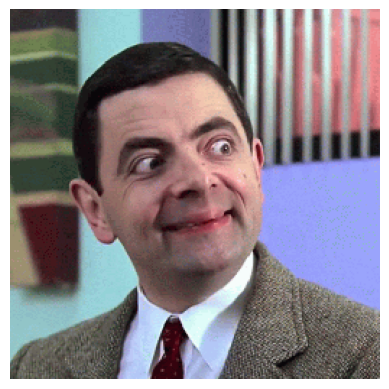

Target Reference Edges: 


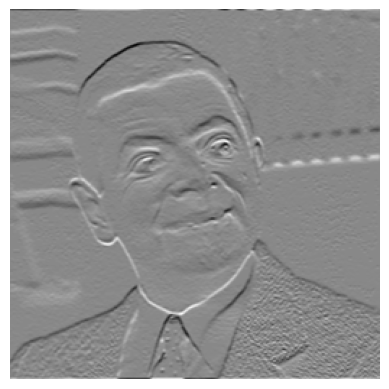

Target Appearance Image: 


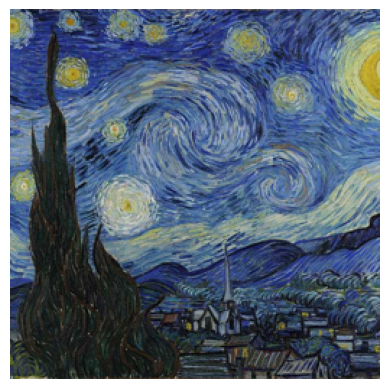

In [112]:
print("Target Reference Image: ")
plt.imshow((target_reference_img[0].detach().cpu().permute(1,2,0).numpy() + 1.0) / 2.0)
plt.axis("off")
plt.show()

print("Target Reference Edges: ")
plt.imshow(target_reference_edges[0][1].detach().cpu().numpy(), cmap='gray')
plt.axis("off")
plt.show()

print("Target Appearance Image: ")
plt.imshow((target_appearance_img[0].detach().cpu().permute(1,2,0).numpy() + 1.0) / 2.0)
plt.axis("off")
plt.show()
# print("Target Vector Field")
# target_flow_vector_field = plot_vec_field(DynamicTextureLoss.loss_mapper["vector_field_motion"].target_motion_vec[0].detach().cpu().numpy(), name='Target')
# target_flow_vector_field

## Setup training

In [113]:
nca_min_steps, nca_max_steps = args.nca_step_range

nca_model = DyNCA(c_in=args.nca_c_in+3, c_out=3, fc_dim=args.nca_fc_dim,
                  seed_mode=args.nca_seed_mode,
                  pos_emb=args.nca_pos_emb, padding_mode=args.nca_padding_mode,
                  perception_scales=nca_perception_scales,
                  device=DEVICE)
with torch.no_grad():
    nca_pool = nca_model.seed(args.nca_pool_size, size=(nca_size_x, nca_size_y))

param_n = sum(p.numel() for p in nca_model.parameters())
print('DyNCA param count:', param_n)

optimizer = torch.optim.Adam(nca_model.parameters(), lr=args.lr)

DynamicTextureLoss = Loss(args, nca_model)

args_log = copy.deepcopy(args.__dict__)
del args_log['DEVICE']
if 'target_motion_vec' in args_log:
    del args_log['target_motion_vec']


if len(args.lr_decay_step) == 0:
    args.lr_decay_step = [[1000, 2000]]

lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer,
                                                    args.lr_decay_step[0],
                                                    0.5)

input_dict = {}  # input dictionary for computing the loss functions
input_dict['target_image_list'] = [target_appearance_img]  # 0,1
input_dict['target_image_edges'] = edge_converter(target_appearance_img)[0]

interval = args.motion_weight_change_interval

loss_log_dict = defaultdict(list)
new_size = (nca_size_x, nca_size_y)

pbar = range(args.max_iterations)

DyNCA param count: 7311
Target Vector Field:  circular
Successfully Loaded two_stream_dynamic model


In [114]:
target_reference_img.shape, target_reference_edges.shape

(torch.Size([25, 3, 256, 256]), torch.Size([25, 3, 256, 256]))

In [115]:
target_appearance_img.requires_grad

False

## Training Loop

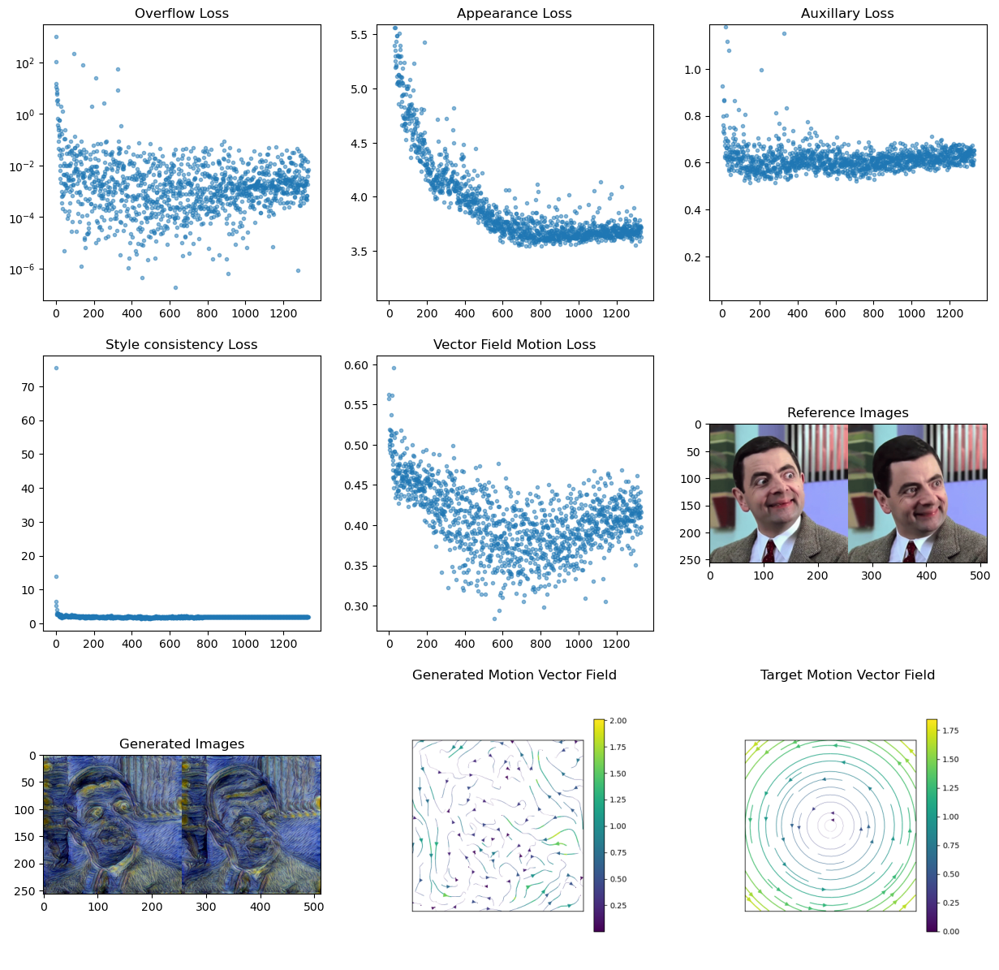

**overflow loss** = 0.003749951720237732

**auxillary loss** = 0.6284404993057251

**vector_field_motion-strength loss** = 0.12175161391496658

**vector_field_motion-direction loss** = 0.7932288646697998

**vector_field_motion loss** = 0.4574902355670929

**appearance loss** = 3.6766393184661865

**style_consistency loss** = 1.853790283203125

**lr**: 0.00025 

**Step**: 555 / 2000 



**overflow loss** = 0.003749951720237732

**auxillary loss** = 0.6284404993057251

**vector_field_motion-strength loss** = 0.12175161391496658

**vector_field_motion-direction loss** = 0.7932288646697998

**vector_field_motion loss** = 0.4574902355670929

**appearance loss** = 3.6766393184661865

**style_consistency loss** = 1.853790283203125

**lr**: 0.00025 

**Step**: 555 / 2000 




Saving latest model checkpoint...


In [124]:
try:
    for i in pbar:
        np.random.seed(i + 424)
        torch.manual_seed(i + 424)
        torch.cuda.manual_seed_all(i + 424)
    
        aux_img_ids = np.random.choice(target_reference_img.size(0), args.batch_size, replace=True)
        aux_imgs = [target_reference_img[img].unsqueeze(0) for img in aux_img_ids]
        aux_imgs = torch.concat(aux_imgs)
        aux_imgs_vis = (aux_imgs + 1.0) / 2.0
        input_dict['auxillary_image_list'] = [aux_imgs]  # 0,1
    
        aux_edges = [target_reference_edges[img].unsqueeze(0) for img in aux_img_ids]
        aux_edges = torch.concat(aux_edges)
        aux_edges_vis = (aux_edges + 1.0) / 2.0
    
        with torch.no_grad():
            batch_idx = np.random.choice(args.nca_pool_size, args.batch_size, replace=False)
            input_states = nca_pool[batch_idx]
            seed_injection = False
            if i % args.nca_inject_seed_step == 0:
                seed_injection = True
                seed_inject = nca_model.seed(1, size=(nca_size_x, nca_size_y))
                input_states[:1] = seed_inject[:1]
            
            input_states = torch.cat((input_states, aux_edges), 1)
            '''Get the image before NCA iteration for computing optic flow'''
            nca_states_before, nca_features_before = nca_model.forward_nsteps(input_states, step_n=1)
            z_before_nca = nca_features_before
            image_before_nca = z_before_nca
    
        step_n = np.random.randint(nca_min_steps, nca_max_steps)
        input_dict['step_n'] = step_n
        nca_states_after, nca_features_after = nca_model.forward_nsteps(input_states, step_n)
    
        z = nca_features_after
        generated_image = z
        with torch.no_grad():
            generated_image_vis = generated_image.clone()
            generated_image_vis = (generated_image_vis + 1.0) / 2.0
    
        image_after_nca = generated_image.clone()
    
        '''Construct input dictionary for loss computation'''
        input_dict['generated_image_list'] = [generated_image]
        input_dict['generated_image_before_nca'] = image_before_nca
        input_dict['generated_image_after_nca'] = image_after_nca
    
        
    
        input_dict['nca_state'] = nca_states_after
    
        if i % args.save_every == 0:
            batch_loss, batch_loss_log_dict, summary = DynamicTextureLoss(input_dict, return_summary=True)
        else:
            batch_loss, batch_loss_log_dict, _ = DynamicTextureLoss(input_dict, return_summary=False)
            summary = {}
    
        for loss_name in batch_loss_log_dict:
            loss_log_dict[loss_name].append(batch_loss_log_dict[loss_name])
    
        # if i % interval == 0 and i > 0:
        #     print("Updating the motion loss weight")
        #     DynamicTextureLoss.set_loss_weight(loss_log_dict["appearance"], "vector_field_motion")
    
        with torch.no_grad():
            batch_loss.backward()
            if torch.isnan(batch_loss):
                print('Loss is NaN. Train Failed. Exit.')
                exit()
    
            for p_name, p in nca_model.named_parameters():
                p.grad /= (p.grad.norm() + 1e-8)  # normalize gradients
                
            optimizer.step()
            optimizer.zero_grad()
            lr_scheduler.step()
    
            nca_pool[batch_idx] = nca_states_after[:, :12, :, :]
            
            # Visualizing the model during training
            if i % args.save_every == 0:
                clear_output(True)
                if 'vector_field_motion-generated_video_flow' in summary:
                    generated_flow_vis = summary['vector_field_motion-generated_video_flow'] / 255.0
                    gen_flow_show = save_train_image(generated_flow_vis[:4], None, return_img = True)
    
                if 'vector_field_motion-generated_flow_vector_field' in summary:
                    generated_flow_vector_field = summary['vector_field_motion-generated_flow_vector_field']
    
                if 'vector_field_motion-target_flow_vector_field' in summary:
                    target_flow_vector_field = summary['vector_field_motion-target_flow_vector_field']
    
                img_show = save_train_image(generated_image_vis.detach().cpu().numpy(), None, return_img = True)
                ref_img_show = save_train_image(aux_imgs_vis.detach().cpu().numpy(), None, return_img = True)
    
                '''Dict: loss log, yscale to log (True/False), ylim (True/False)'''
                plot_log_dict = {}
                plot_log_dict['Overflow Loss'] = (loss_log_dict['overflow'], True, True)
                num_plots = 1
                if "appearance" in loss_log_dict:
                    num_plots += 1
                    plot_log_dict['Texture Loss'] = (loss_log_dict['appearance'], True, True)
    
                if "vector_field_motion" in loss_log_dict:
                    plot_log_dict = {}
                    plot_log_dict['Motion Loss'] = (
                        loss_log_dict['vector_field_motion'], False, False)
                    plot_log_dict['Motion Direction Loss'] = (
                        loss_log_dict['vector_field_motion-direction'], False, False)
                    plot_log_dict['Motion Strength Loss'] = (
                        loss_log_dict['vector_field_motion-strength'], False, False)
                
                plt.figure(figsize = (15, 15))
                
                plt.subplot(3,3,1)
                plt.title("Overflow Loss", fontsize = 12)
                plt.plot(loss_log_dict['overflow'], '.', alpha = 0.5)
                plt.yscale('log')
                
                plt.subplot(3,3,2)
                plt.title("Appearance Loss", fontsize = 12)
                plt.plot(loss_log_dict['appearance'], '.',alpha = 0.5)
                plt.ylim(np.min(loss_log_dict['appearance']) - 0.5, np.quantile(loss_log_dict['appearance'], 0.95) + 0.5)
    
    
                plt.subplot(3,3,3)
                plt.title("Auxillary Loss", fontsize = 12)
                plt.plot(loss_log_dict['auxillary'], '.',alpha = 0.5)
                plt.ylim(np.min(loss_log_dict['auxillary']) - 0.5, np.quantile(loss_log_dict['auxillary'], 0.95) + 0.5)

                plt.subplot(3,3,4)
                plt.title("Style consistency Loss", fontsize = 12)
                plt.plot(loss_log_dict['style_consistency'], '.', alpha = 0.5)
                
                
                plt.subplot(3,3,5)
                plt.title("Vector Field Motion Loss", fontsize = 12)
                plt.plot(loss_log_dict['vector_field_motion'], '.', alpha = 0.5)
                
                # plt.subplot(3,3,4)
                # plt.title("Motion Direction Loss", fontsize = 12)
                # plt.plot(loss_log_dict['vector_field_motion-direction'], '.', alpha = 0.5)
                
                # plt.subplot(3,3,5)
                # plt.title("Motion Strength Loss", fontsize = 12)
                # plt.plot(loss_log_dict['vector_field_motion-strength'], '.', alpha = 0.5)
    
                plt.subplot(3,3,6)
                plt.title("Reference Images", fontsize = 12)
                plt.imshow(ref_img_show)
                

                plt.subplot(3,3,7)
                plt.title("Generated Images", fontsize = 12)
                plt.imshow(img_show)
                
                # plt.subplot(3,3,7)
                # plt.title("Generated Optic Flow", fontsize = 12)
                # plt.imshow(gen_flow_show)
                
                plt.subplot(3,3,8)
                plt.axis("off")
                plt.title("Generated Motion Vector Field", fontsize = 12)
                plt.imshow(generated_flow_vector_field)
                
                plt.subplot(3,3,9)
                plt.axis("off")
                plt.title("Target Motion Vector Field", fontsize = 12)
                plt.imshow(target_flow_vector_field)
                
    
                plt.show()
            
            if i % 5 == 0:
                display_dict = copy.deepcopy(batch_loss_log_dict)
                display_str = "\n\n".join([f"**{k} loss** = {display_dict[k]}" for k in display_dict])
                display_str += f"\n\n**lr**: {lr_scheduler.get_lr()[0]} \n\n"
                display_str += f"**Step**: {i} / {args.max_iterations} \n\n"
                
                display(Markdown(display_str), display_id='stats')

except (KeyboardInterrupt, torch.cuda.OutOfMemoryError) as e:
    print(e)
    print('Saving latest model checkpoint...')
    
torch.save(nca_model, f"model-{args.exp_name}.pth")

## Generate Videos

In [125]:
exp_name = args.exp_name
texture_name = args.style_name
nca_model = torch.load(f'model-{exp_name}.pth')

In [126]:
def save_video(video_name, target_vid_path, size_factor=1.0, step_n=8, steps_per_frame=1, is_style_image=False):


    target_vid = preprocess_video(target_vid_path,
                                    img_size=(int(nca_size_x * size_factor), int(nca_size_y * size_factor)))  # [C, T, H, W]
    

    target_vid = target_vid.permute(1,0,2,3).to(DEVICE)
    
    with VideoWriter(filename=f"{video_name}.mp4", fps=30, autoplay=True) as vid, torch.no_grad():
        h = nca_model.seed(1, size=(int(nca_size_x * size_factor), int(nca_size_y * size_factor)))

        

        for frame in tqdm(range(target_vid.size(0)),  desc="Making the video..."):
            for k in range(int(steps_per_frame)):
                f = 1 if not is_style_image else 90
                for i in range(f):
    
                    h = torch.cat((h, target_vid[frame].unsqueeze(0)), 1)
                    nca_state, nca_feature = nca_model.forward_nsteps(h, step_n)
    
                    z = nca_feature
                    h = nca_state[:, :-3, :, :]
    
                    img = z.detach().cpu().numpy()[0]
                    img = img.transpose(1, 2, 0)
                    img = np.clip(img, -1.0, 1.0)
                    img = (img + 1.0) / 2.0
                    vid.add(img)
            

### Generate videos with large size WITHOUT re-training.

In [127]:
save_video(f"videos/corgi-{exp_name}", "data/Reference/corgi.gif", size_factor=2.0, step_n=int(args.nca_base_num_steps), steps_per_frame=10)

Making the video...: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.77it/s]


In [128]:
save_video(f"videos/got-{exp_name}", "data/Reference/got.gif", size_factor=3.0, step_n=int(args.nca_base_num_steps), steps_per_frame=2)

Making the video...: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 113/113 [00:28<00:00,  3.98it/s]


In [133]:
save_video(f"videos/mr-bean-{exp_name}", "data/Reference/mr-bean.gif", size_factor=2.0, step_n=int(args.nca_base_num_steps), steps_per_frame=2)

Making the video...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:02<00:00,  8.80it/s]


In [130]:
save_video(f"videos/raed-{exp_name}", "data/Reference/raed.mp4", size_factor=2.0, step_n=int(args.nca_base_num_steps), steps_per_frame=2)

Making the video...: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 177/177 [00:20<00:00,  8.81it/s]


In [131]:
save_video(f"videos/{exp_name}", f"data/Reference/{texture_name}.gif", size_factor=2.0, step_n=int(args.nca_base_num_steps), steps_per_frame=2, is_style_image=True)

Making the video...: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:10<00:00, 10.12s/it]
